# Part III: Spatial Clustering and Analysis

## Identifying Cellular Structures

### Overview
Following the selection of the batch correction model, we performed spatially aware clustering of the embedded space using the **SpatialLeiden** package. This approach grouped cells with similar transcriptional profiles while incorporating their spatial context.

Key steps included:
1. **Dimensionality Reduction**: Using Principal Component Analysis (PCA) to simplify the dataset while retaining its key features.
2. **kNN Graph Construction**: A k-nearest neighbor (kNN) graph was built to capture relationships between cells.
3. **Clustering**: Cells were clustered using the Leiden or Louvain algorithms, revealing distinct populations of cells within the sample.

To integrate spatial information, we used the **SpatialLeiden** algorithm. This method combines the gene expression embedding space with the spatial location of cells, resulting in a comprehensive analysis that considers both molecular and spatial contexts.

---

### Two-Step Analysis

1. **Observation**:  
   Selected punches from different mice and conditions were visualized side by side to compare across time points.

2. **Investigation**:  
   The spatial relationships among the clusters were explored to understand their spatial organization and interactions.  
   Marker genes for each identified cluster were examined through differential expression analysis to characterize cell populations.


In [1]:
import warnings
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", RuntimeWarning)

In [2]:
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib.colors import ListedColormap
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.ticker import MaxNLocator
import seaborn as sns
import os
import gzip
import numpy as np
import scanpy as sc
import squidpy as sq
import cupy as cp
import cupyx
from cupyx.scipy.sparse import csr_matrix 
import os
import time
import rapids_singlecell as rsc
import numpy as np
import rmm
from rmm.allocators.cupy import rmm_cupy_allocator
import cupy

rmm.reinitialize(
    managed_memory=False,  # Allows oversubscription
    pool_allocator=False,  # default is False
    devices=0,  # GPU device IDs to register. By default registers only GPU 0.
)
cp.cuda.set_allocator(rmm_cupy_allocator)
import zarr
import pickle
from collections import OrderedDict
from scipy.sparse import csr_matrix
import pandas as pd
import scipy.stats as stats
from statsmodels.stats.multitest import multipletests
from scipy.sparse import csr_matrix
import scipy
import anndata
from collections import OrderedDict
import anndata as ad
import warnings
import random 

In [3]:
pathout = '/data/kanferg/Sptial_Omics/projects/NguyenLab/spatialomicstoolkit/out_1'
adata_concat = sc.read_h5ad(os.path.join(pathout, "andata_filter_logNorm_hvg_leiden_harmony_spatialleiden.h5ad"))

In [4]:
def plot_spatial(andata,ax, cluster = 'cluster', features = None,title = '',xlab = '',ylab ='',size = 2,alpha = 0.6, markerscale = 5, cluster_name = 'cluster',show_legend = True):
    # import random 
    palette = sns.color_palette("tab10") + sns.color_palette("tab20b") + sns.color_palette("tab20") 
    random.seed(1000)
    palette = palette[:] 
    random.shuffle(palette) 
    df = pd.DataFrame({'cluster':andata.obs[cluster],'x':andata.obsm['spatial'][:,0],'y':andata.obsm['spatial'][:,1]})
    if features:
        df[df['cluster'].isin([features])]
    num_classes = len(df['cluster'].unique())
    if num_classes==1:
        listed_cmap = ListedColormap(palette)
    else:
        num_classes = len(np.unique(df['cluster'].values))
        extended_palette = palette * (num_classes // len(palette) + 1)
        extended_palette = extended_palette[:num_classes]
        listed_cmap = ListedColormap(extended_palette)
    color_container = []
    
    clusters = sorted(np.unique(df['cluster'].values), key=int)
    for i, cluster in enumerate(clusters):
        cluster_data = df[df['cluster'] == cluster]
        if show_legend:
            ax.scatter( x=cluster_data['x'], y=cluster_data['y'], color=listed_cmap(i), label=f'{cluster}', s=size, alpha=alpha)
        else:
            ax.scatter( x=cluster_data['x'], y=cluster_data['y'], color=listed_cmap(i), s=size, alpha=alpha)
        color_container.append(listed_cmap(i))
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlabel(xlab)
    ax.set_ylabel(ylab)
    ax.set_title(title)
    if show_legend:
        legend = ax.legend( title=cluster_name,
                            bbox_to_anchor=(1.05, 1),  # Position the legend outside the plot
                            loc='upper left',
                            fontsize='small',  # Control the font size
                            title_fontsize='medium',
                            markerscale=markerscale,  # Increase the size of the legend markers
                            frameon=False# Control the title font size
                            )
    df_color = pd.DataFrame({"clusters":df['cluster'].unique(),"colors":color_container})
    return df_color

In [2]:
Experimental_design_file = '/data/kanferg/Sptial_Omics/projects/NguyenLab/spatialomicstoolkit/Experimental_design/Experimental_Design.csv'
ed = pd.read_csv(Experimental_design_file)
column_sel = ed.columns[2:4].tolist()+ed.columns[5:8].tolist()

from tqdm import tqdm
# adding covrites per batch to andata
for column in column_sel:
    adata_concat.obs[column] = None
    for batch in tqdm(ed['Polygon']):
        covraite_temp = ed.loc[ed["Polygon"]==batch,column].values.tolist()*len(adata_concat.obs.loc[adata_concat.obs["batch"]==str(batch),column])
        adata_concat.obs.loc[adata_concat.obs["batch"]==str(batch),column] = covraite_temp
adata_concat.obs['Condition '] = adata_concat.obs['Condition '].astype("category")
adata_concat.obs['Technical_repeat'] = adata_concat.obs['Technical_repeat'].astype("category")
adata_concat.obs['Mouse_ID'] = adata_concat.obs['Mouse_ID'].astype("category")
adata_concat.obs['Harvest_Day'] = adata_concat.obs['Harvest_Day'].astype("category")
def select_slide(adata, s, s_col='sample'):
    r""" Select data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial samples
    :param s: name of selected sample
    :param s_col: column in adata.obs listing sample name for each location
    """
    slide = adata[adata.obs[s_col]==s,:].copy()
    return slide

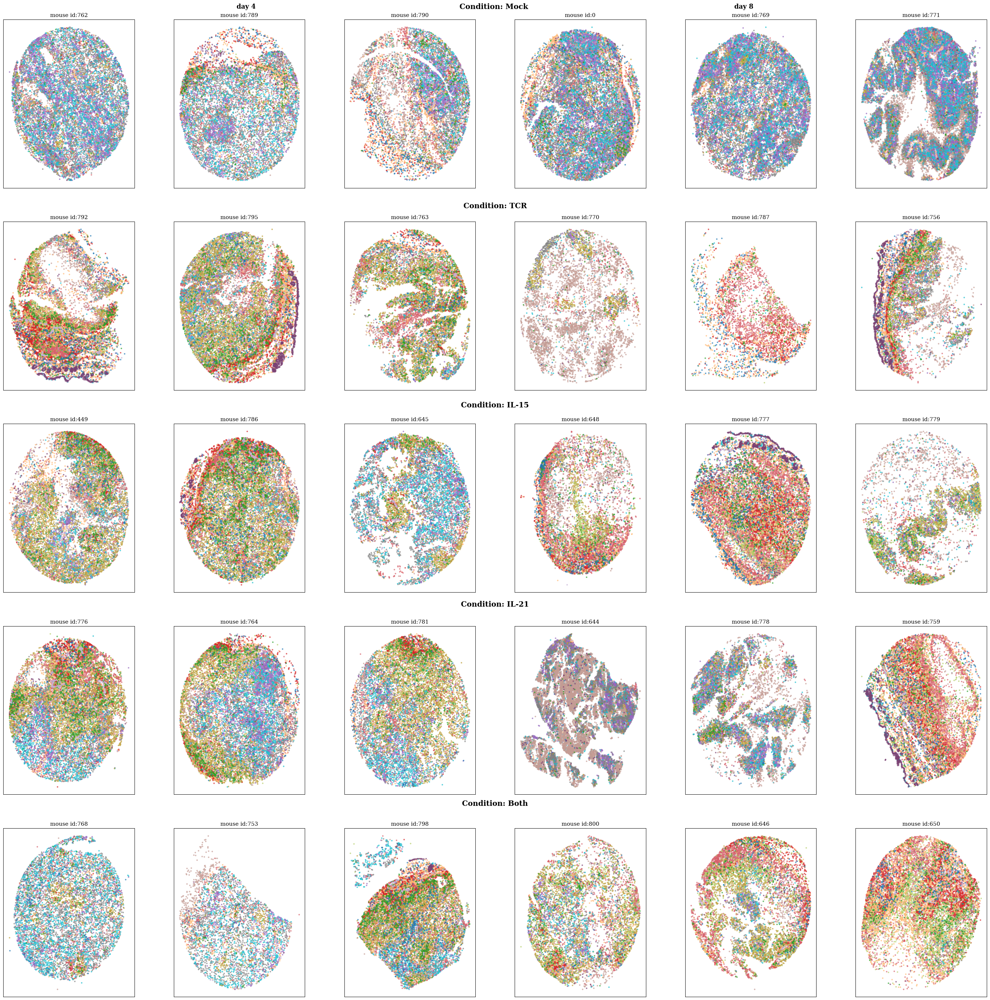

In [9]:
fig, ax = plt.subplots(5, 6, figsize=(30,30))
ax = ax.ravel()

# Adjust matplotlib settings
plt.rcParams['figure.dpi'] = 92
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

count = 0 
postion_title = [1,0.8,0.6,0.4,0.2]
for row_idx,con in zip(postion_title,pd.unique(ed['Condition '])):
    tempdf = ed.loc[ed['Condition '] == str(con)]
    samples = [str(i) for i in pd.unique(tempdf['Polygon']).tolist()]
    sel_andata = adata_concat[adata_concat.obs['Condition ']==con].copy()
    
    sel_andata_4 = sel_andata[sel_andata.obs['Harvest_Day']==4,:].copy() 
    br = list(set(sel_andata_4.obs["batch"].values))
    mouse_name = list(set(sel_andata_4.obs["Mouse_ID"].values))
    for i in range(3):
        if len(mouse_name) < 3:
            sel_andata_4_temp =  sel_andata_4[sel_andata_4.obs["batch"]==br[i]].copy()
            _ = plot_spatial(sel_andata_4_temp,ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name[i]}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
            count += 1
        else:
            sel_andata_4_temp =  sel_andata_4[sel_andata_4.obs["Mouse_ID"]==mouse_name[i]].copy()
            batch = list(set(sel_andata_4_temp.obs["batch"].values))
            sel_andata_4_temp_br = sel_andata_4_temp[sel_andata_4_temp.obs["batch"]==batch[0]].copy()
            _ = plot_spatial(sel_andata_4_temp_br,ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name[i]}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
            count += 1
    
    del sel_andata_4_temp
    del sel_andata_4
    
    sel_andata_8 = sel_andata[sel_andata.obs['Harvest_Day']==8,:].copy() 
    br = list(set(sel_andata_8.obs["batch"].values))
    mouse_name = list(set(sel_andata_8.obs["Mouse_ID"].values))
    for i in range(3):
        if len(mouse_name) < 3:
            sel_andata_8_temp =  sel_andata_8[sel_andata_8.obs["batch"]==br[i]].copy()
            _ = plot_spatial(sel_andata_8_temp,ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name[i]}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
            count += 1
        else:
            sel_andata_8_temp =  sel_andata_8[sel_andata_8.obs["Mouse_ID"]==mouse_name[i]].copy()
            batch = list(set(sel_andata_8_temp.obs["batch"].values))
            sel_andata_8_temp_br = sel_andata_8_temp[sel_andata_8_temp.obs["batch"]==batch[0]].copy()
            _ = plot_spatial(sel_andata_8_temp_br,ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name[i]}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
            count += 1
    
    del sel_andata_8_temp
    del sel_andata_8
    
    
    fig.text(
        0.5,                           # X-coordinate (center of the figure)
        row_idx,     # Y-coordinate (adjusted by row index)
        f"Condition: {con}",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=16, fontweight='bold'
    )
fig.text(
        0.25,                           # X-coordinate (center of the figure)
        1,     # Y-coordinate (adjusted by row index)
        f"day 4",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=14, fontweight='bold'
    )
fig.text(
        0.75,                           # X-coordinate (center of the figure)
        1,     # Y-coordinate (adjusted by row index)
        f"day 8",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=14, fontweight='bold'
    )
#plt.suptitle("Unintegrated", fontsize=16, fontweight='bold')
# Adjust layout to avoid overlaps
plt.tight_layout()
plt.subplots_adjust(wspace = 0.3, hspace=0.2)
# Show the plot
plt.show()

It appears that some samples may be outliers. For example, mouse 787 (batch 33) and mouse 644 exhibit characteristics of outliers. Additionally, interesting patterns can be observed, such as distinct layers at the edges of the samples, particularly in mouse 759.

### Neighborhood Analysis

To further investigate these findings, we will explore the spatial relationships among the clusters to better understand their spatial organization and interactions. A spatial neighbors graph will be computed to visualize the spatial patterns of the clusters, assess their proximity, and examine potential inter-cluster communication. This analysis will provide valuable insights into the spatial structure within the tissue.



In [55]:
adata_concat.X = adata_concat.layers['log'].copy()
import squidpy as sq
sq.gr.spatial_neighbors(adata_concat, coord_type="generic",delaunay = True)
sq.gr.nhood_enrichment(adata_concat, cluster_key="spatialleiden")

/usr/local/apps/rapids-singlecell/mamba/envs/rapids_singlecell/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
100%|████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:55<00:00, 18.11/s]


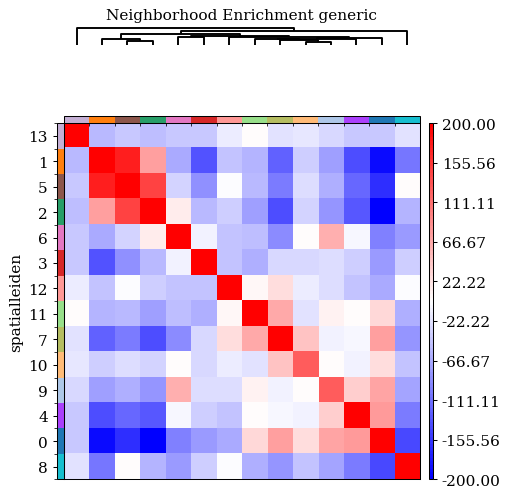

In [58]:
from matplotlib.colors import LinearSegmentedColormap

colors = [(0, 0, 1), (1, 1, 1), (1, 0, 0)]  # Blue -> White -> Red
n_bins = 100  # Discretize into 100 bins
custom_cmap = LinearSegmentedColormap.from_list('custom_cmap', colors, N=n_bins)

plt.rcParams['figure.dpi'] = 92
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

sq.pl.nhood_enrichment(
    adata_concat,
    title = "Neighborhood Enrichment generic",
    cluster_key="spatialleiden",
    method="average",
    cmap=custom_cmap,
    vmin=-200,
    vmax=200,
    figsize=(5, 5),
)
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.2)

### Gene Enrichment

Notably, clusters 1, 5, and 2 appear to be more correlated, suggesting potential biological or spatial relationships among them. In addition, differential gene expression analysis will be performed to determine if certain clusters, such as 1, 5, and 2, can be merged or if they remain distinctly separated. This will involve analyzing the top two marker genes expressed in each cluster.

In [64]:
# rsc.get.anndata_to_CPU(andata)
adata_concat.obs["spatialleiden"] = adata_concat.obs["spatialleiden"].astype(str)

In [59]:
sc.tl.rank_genes_groups(adata_concat, groupby="spatialleiden", method="wilcoxon")

         Falling back to preprocessing with `sc.pp.pca` and default params.


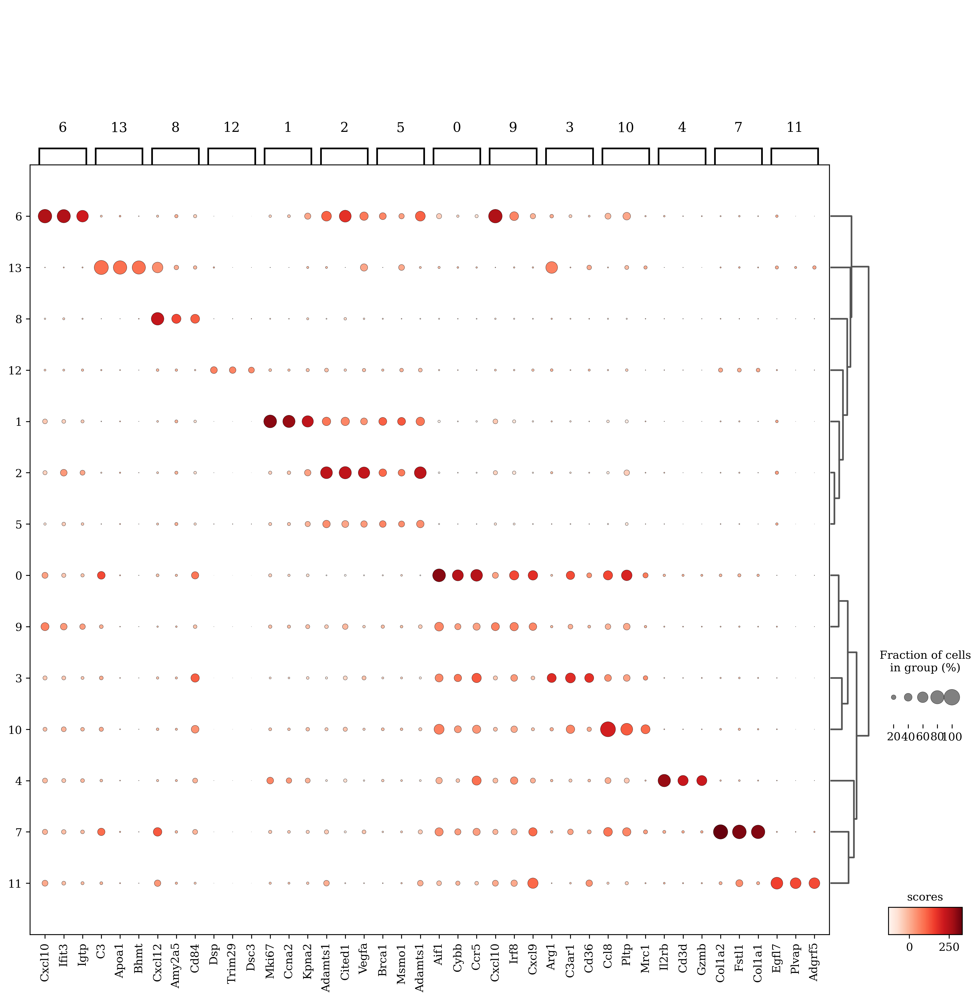

<Figure size 1920x1440 with 0 Axes>

In [65]:
fig, ax = plt.subplots(1, 1, figsize=(15,15))
plt.rcParams['figure.dpi'] = 300
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
sc.pl.rank_genes_groups_dotplot(adata_concat, groupby="spatialleiden",n_genes=3,values_to_plot = 'scores',ax =ax)
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.2)

Let’s revisit the spatial mapping by displaying all the samples grouped by batches and divided into conditions. We'll begin with the 4-day harvest:

In [43]:
df = {c:[] for c in pd.unique(ed['Condition '])}
for row_idx,con in zip(postion_title,pd.unique(ed['Condition '])):
    sel_andata = adata_concat[adata_concat.obs['Condition ']==con,:].copy()
    sel_andata = sel_andata[sel_andata.obs['Harvest_Day']==4,:].copy()
    samples = [str(i) for i in pd.unique(sel_andata.obs['batch']).tolist()]
    df[con] = len(samples)

In [6]:
count = 0 
postion_title = [1,0.8,0.6,0.4,0.2]

for row_idx,con in zip(postion_title,pd.unique(ed['Condition '])):
    sel_andata_ = adata_concat[adata_concat.obs['Condition ']==con,:].copy()
    sel_andata = sel_andata_[sel_andata_.obs['Harvest_Day']==4,:].copy()
    samples = [str(i) for i in pd.unique(sel_andata.obs['batch']).tolist()]
    for batch in samples:
        sel_andata_4 = sel_andata[sel_andata.obs['batch']==batch].copy()
        mouse_name = list(set(sel_andata_4.obs["Mouse_ID"]))
        #_ = plot_spatial(sel_andata_4,ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name[0]}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
        count += 1
        print(f'{count}')

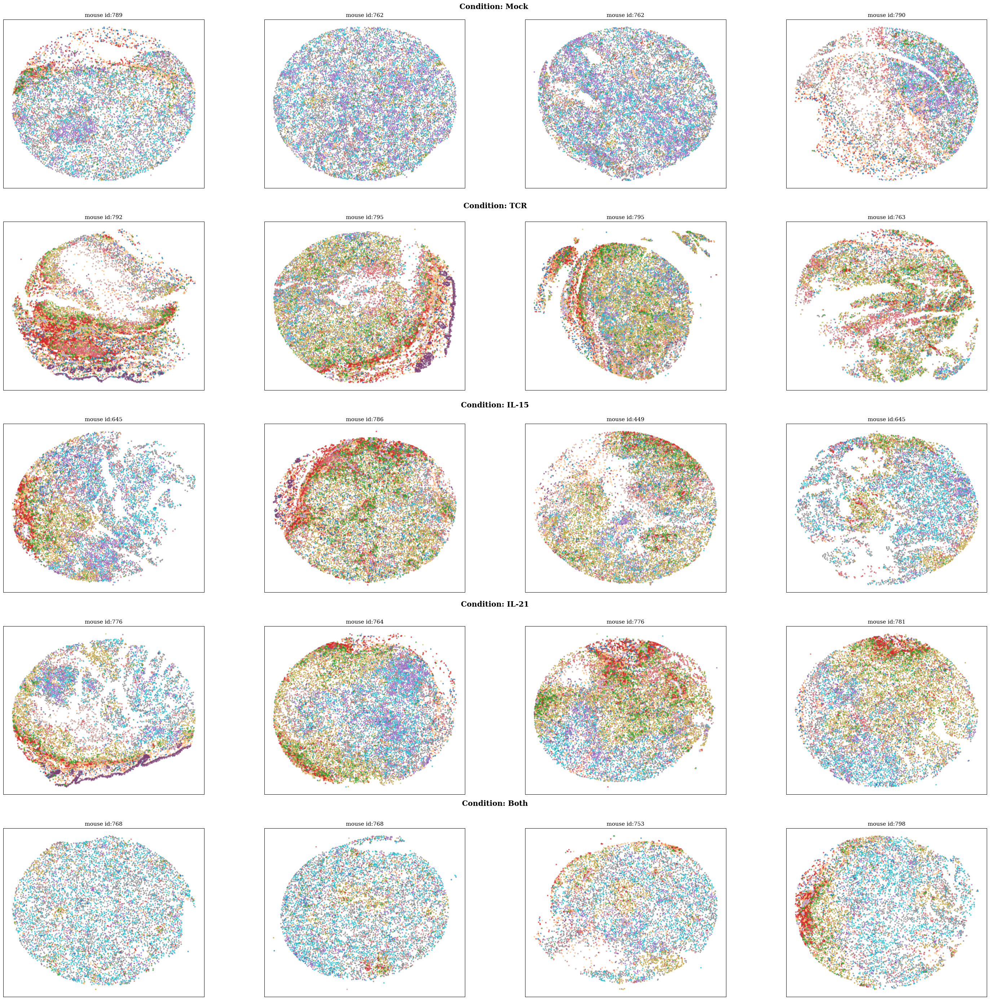

In [45]:
fig, ax = plt.subplots(5, 4, figsize=(30,30))
ax = ax.ravel()

# Adjust matplotlib settings
plt.rcParams['figure.dpi'] = 92
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

count = 0 
postion_title = [1,0.8,0.6,0.4,0.2]

for row_idx,con in zip(postion_title,pd.unique(ed['Condition '])):
    sel_andata_ = adata_concat[adata_concat.obs['Condition ']==con,:].copy()
    sel_andata = sel_andata_[sel_andata_.obs['Harvest_Day']==4,:].copy()
    samples = [str(i) for i in pd.unique(sel_andata.obs['batch']).tolist()]
    for batch in samples:
        if count==20:
            continue
        else:
            sel_andata_4 = sel_andata[sel_andata.obs['batch']==batch].copy()
            mouse_name = list(set(sel_andata_4.obs["Mouse_ID"]))
            _ = plot_spatial(sel_andata_4,ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name[0]}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
            count += 1
        
    fig.text(
        0.5,                           # X-coordinate (center of the figure)
        row_idx,     # Y-coordinate (adjusted by row index)
        f"Condition: {con}",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=16, fontweight='bold'
    )
#plt.suptitle("Unintegrated", fontsize=16, fontweight='bold')
# Adjust layout to avoid overlaps
plt.tight_layout()
plt.subplots_adjust(wspace = 0.3, hspace=0.2)
# Show the plot
plt.show()

8-day harvest

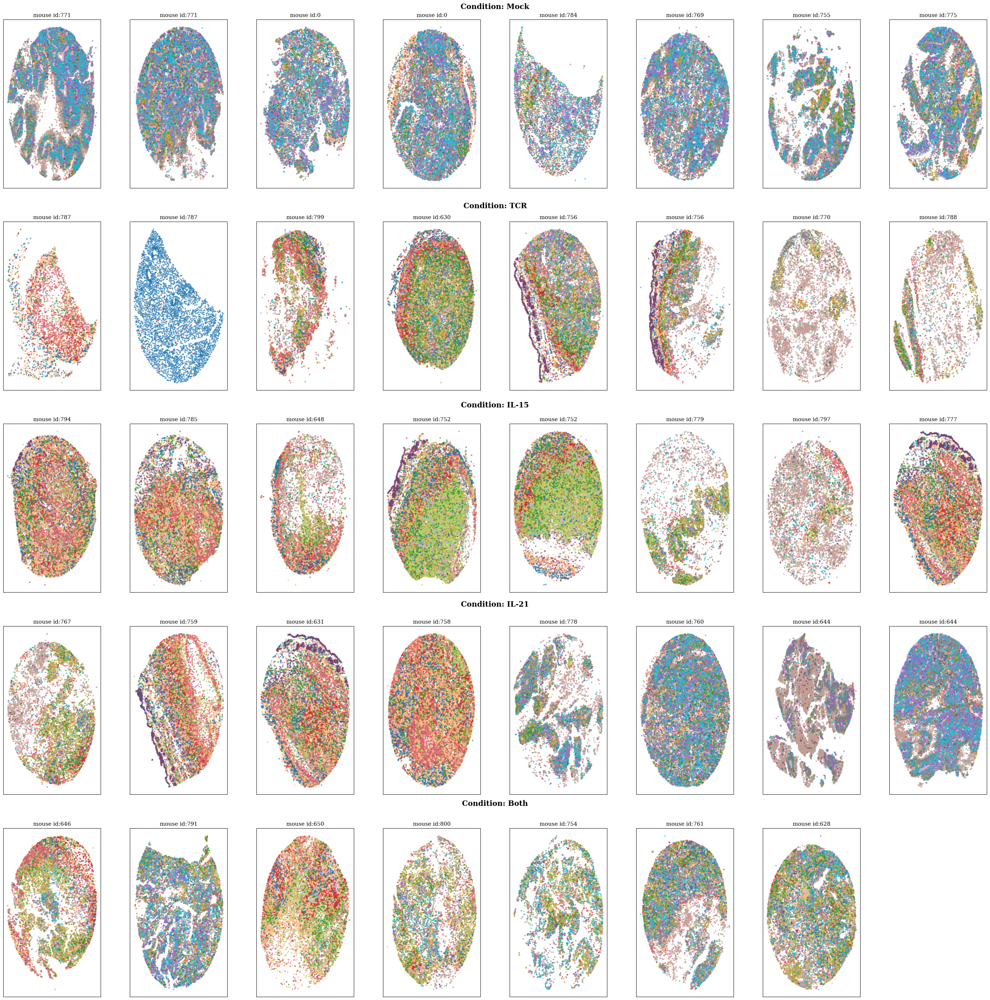

In [18]:
fig, ax = plt.subplots(5, 8, figsize=(30,30))
ax = ax.ravel()

# Adjust matplotlib settings
plt.rcParams['figure.dpi'] = 92
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12


postion_title = [1,0.8,0.6,0.4,0.2]
samp = [1,56,27,30,60,2,28,24]
count = 0
for i,batch in enumerate(samp):
    sel_andata = adata_concat[adata_concat.obs['batch']==str(batch),:].copy()
    mouse_name = list(set(sel_andata.obs["Mouse_ID"]))[0]
    _ = plot_spatial(sel_andata, ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
    count += 1
fig.text(
        0.5,                           # X-coordinate (center of the figure)
        1,     # Y-coordinate (adjusted by row index)
        f"Condition: Mock",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=16, fontweight='bold'
    )
#ax[count].axis('off')
#count += 1

samp = [33,32,37,41,23,45,11,8]
for i,batch in enumerate(samp):
    sel_andata = adata_concat[adata_concat.obs['batch']==str(batch),:].copy()
    mouse_name = list(set(sel_andata.obs["Mouse_ID"]))[0]
    _ = plot_spatial(sel_andata, ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
    count += 1
fig.text(
        0.5,                           # X-coordinate (center of the figure)
        0.8,     # Y-coordinate (adjusted by row index)
        f"Condition: TCR",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=16, fontweight='bold'
    )

samp = [49,53,48,19,44,6,3,0]
for i,batch in enumerate(samp):
    sel_andata = adata_concat[adata_concat.obs['batch']==str(batch),:].copy()
    mouse_name = list(set(sel_andata.obs["Mouse_ID"]))[0]
    _ = plot_spatial(sel_andata, ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
    count += 1
fig.text(
        0.5,                           # X-coordinate (center of the figure)
        0.6,     # Y-coordinate (adjusted by row index)
        f"Condition: IL-15",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=16, fontweight='bold'
    )

samp = [57,52,61,31,20,16,9,12]
for i,batch in enumerate(samp):
    sel_andata = adata_concat[adata_concat.obs['batch']==str(batch),:].copy()
    mouse_name = list(set(sel_andata.obs["Mouse_ID"]))[0]
    _ = plot_spatial(sel_andata, ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
    count += 1
fig.text(
        0.5,                           # X-coordinate (center of the figure)
        0.4,     # Y-coordinate (adjusted by row index)
        f"Condition: IL-21",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=16, fontweight='bold'
    )

samp = [40,36,15,25,21,17,13]
for i,batch in enumerate(samp):
    sel_andata = adata_concat[adata_concat.obs['batch']==str(batch),:].copy()
    mouse_name = list(set(sel_andata.obs["Mouse_ID"]))[0]
    _ = plot_spatial(sel_andata, ax = ax[count], cluster = 'spatialleiden', features = None, title = f'mouse id:{mouse_name}',markerscale = 1, xlab = '',ylab ='',size = 5,show_legend = False)
    count += 1
ax[count].axis('off')
fig.text(
        0.5,                           # X-coordinate (center of the figure)
        0.2,     # Y-coordinate (adjusted by row index)
        f"Condition: Both",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=16, fontweight='bold'
    )


plt.tight_layout()
plt.subplots_adjust(wspace = 0.3, hspace=0.2)
# Show the plot
plt.show()